## Anaylsis Model Errors

In [1]:
import os
import warnings
import random
from pprint import pprint
import copy
from typing import List, Tuple
import glob
import json
import csv
# import dataclasses
from joblib import Parallel, delayed
from typing import List, Set, Dict, Any

from tqdm import tqdm
import numpy as np
import pandas as pd
from box import Box, from_file
import matplotlib.pyplot as plt
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score
from scipy.optimize import minimize
from sklearn.metrics import jaccard_score
import cv2
import seaborn as sns

In [70]:
class CFG(object):
    # basic
    debug: bool = False
    debug_sample: int = 64
    folds: int  = 4
    seed: int   = 417
    eps: float  = 1e-12
    
    # data
    PATH_CSV: str  =  f'../data/002_Full+California/012_seed417.csv'
    PATH_DATA = 'output/'
    outdir = 'output/analysis/error/'
    os.makedirs(outdir, exist_ok=True)
    
# box
cfg = Box({k:v for k, v in dict(vars(CFG)).items() if '__' not in k})
    
# 乱数のシードを設定
np.random.seed(cfg.seed)
random.seed(cfg.seed)
    
pprint(cfg)

{'PATH_CSV': '../data/002_Full+California/012_seed417.csv',
 'PATH_DATA': 'output/',
 'debug': False,
 'debug_sample': 64,
 'eps': 1e-12,
 'folds': 4,
 'outdir': 'output/analysis/error/',
 'seed': 417}


In [71]:
TARGET_VERSIONS = [6, 7, 8]

dfs = []

for ver in TARGET_VERSIONS:
    PATHS = glob.glob(f'{cfg.PATH_DATA}/V{ver}/*/*/inference/oof_fold*.csv')
    for _p in tqdm(PATHS):
        df = pd.read_csv(_p)
        df['csv'] = _p
        dfs.append(df)
   
df = pd.concat(dfs, axis=0) 
df.head(4)

100%|██████████| 9/9 [00:00<00:00, 400.50it/s]
0it [00:00, ?it/s]


,name,feature,mask,defects,fold,hight,width,california,cv,tp,...,recall,f1,iou,threshold,positive,positive_ratio,csv,pre_missing,post_missing,ratio
0,0328d12a-4ad8-4504-8ac5-70089db10b4e_1,../data/002_Full+California/img/0328d12a-4ad8-...,../data/002_Full+California/ann/0328d12a-4ad8-...,False,4,512,512,False,0,110,...,0.320700,0.485648,0.044444,0.360552,True,0.001308,output//V6/3090_V6_CALFalseDEFFalseNONFalse_hr...,NaN,NaN,NaN
1,03790d1a-5b9c-48ed-820d-83abbe656035_1,../data/002_Full+California/img/03790d1a-5b9c-...,../data/002_Full+California/ann/03790d1a-5b9c-...,False,3,512,512,False,0,1009,...,0.840833,0.909414,0.565583,0.388706,True,0.004578,output//V6/3090_V6_CALFalseDEFFalseNONFalse_hr...,NaN,NaN,NaN
2,039885ad-e4f2-461e-9784-60508d0a7ab5_1,../data/002_Full+California/img/039885ad-e4f2-...,../data/002_Full+California/ann/039885ad-e4f2-...,False,1,512,512,False,0,5406,...,0.902806,0.918212,0.708984,0.396888,True,0.022842,output//V6/3090_V6_CALFalseDEFFalseNONFalse_hr...,NaN,NaN,NaN
3,039885ad-e4f2-461e-9784-60508d0a7ab5_2,../data/002_Full+California/img/039885ad-e4f2-...,../data/002_Full+California/ann/039885ad-e4f2-...,False,1,512,512,False,0,28466,...,0.866677,0.904338,0.568956,0.502820,True,0.125294,output//V6/3090_V6_CALFalseDEFFalseNONFalse_hr...,NaN,NaN,NaN


In [72]:
df.columns, df.shape

(Index(['name', 'feature', 'mask', 'defects', 'fold', 'hight', 'width',
        'california', 'cv', 'tp', 'fp', 'fn', 'precision', 'recall', 'f1',
        'iou', 'threshold', 'positive', 'positive_ratio', 'csv', 'pre_missing',
        'post_missing', 'ratio'],
       dtype='object'),
 (1769, 23))

In [73]:
iou_under = 0.25

df = df[df['positive'] == True]
df = df[df['iou'] < iou_under]

df.shape

(748, 23)

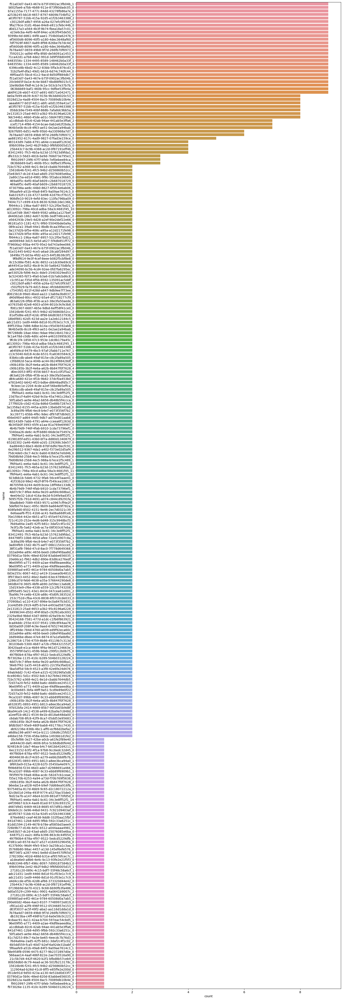

In [78]:
plt.figure(figsize=(16, 60))
sns.countplot(data=df, y="name", order=df['name'].value_counts().index)
plt.savefig(f'{cfg.outdir}/015_count_name.png')
plt.show();
plt.clf()
plt.close()

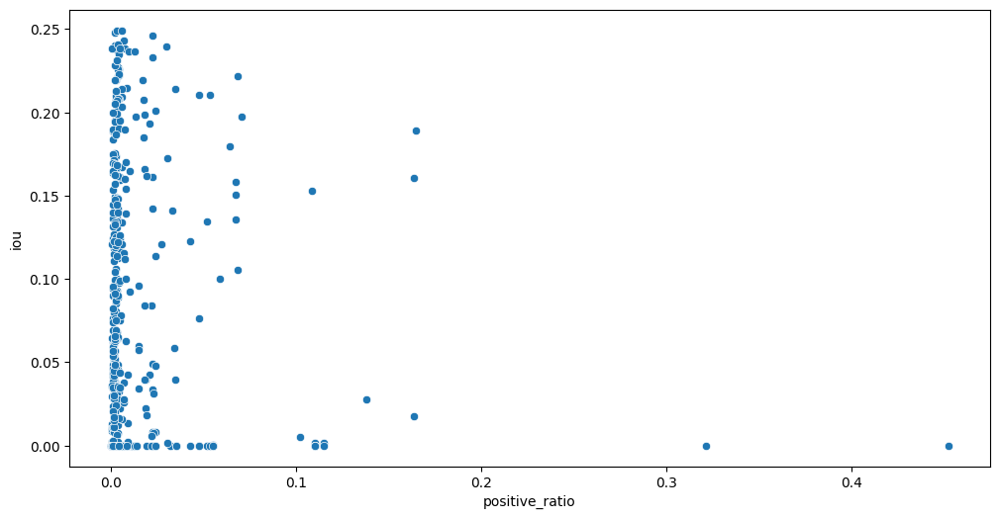

In [79]:
plt.figure(figsize=(12, 6))
sns.scatterplot(data=df, x="positive_ratio", y="iou")
plt.savefig(f'{cfg.outdir}/015_scatter_iou-positive_ratio.png')
plt.show();
plt.clf()
plt.close()

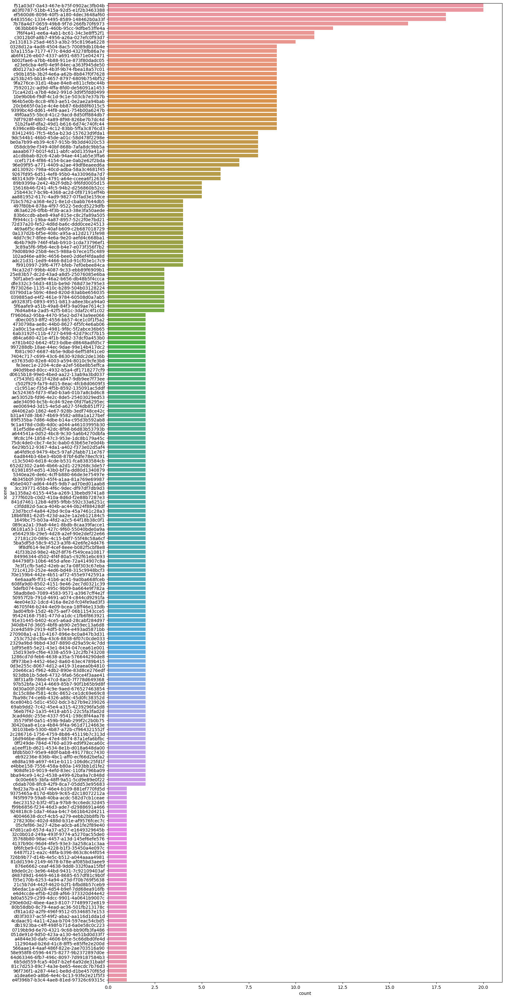

In [74]:
df['scene'] = df['name'].apply(lambda x: x.split('_')[0])

plt.figure(figsize=(16, 40))
sns.countplot(data=df, y="scene", order=df['scene'].value_counts().index)
plt.savefig(f'{cfg.outdir}/015_count_scene.png')
plt.show();
plt.clf()
plt.close()

In [87]:
# reoder by scene
df.name.value_counts()
df.head(6)

,name,feature,mask,defects,fold,hight,width,california,cv,tp,...,f1,iou,threshold,positive,positive_ratio,csv,pre_missing,post_missing,ratio,scene
0,0328d12a-4ad8-4504-8ac5-70089db10b4e_1,../data/002_Full+California/img/0328d12a-4ad8-...,../data/002_Full+California/ann/0328d12a-4ad8-...,False,4,512,512,False,0,110,...,0.485648,0.044444,0.360552,True,0.001308,output//V6/3090_V6_CALFalseDEFFalseNONFalse_hr...,NaN,NaN,NaN,0328d12a-4ad8-4504-8ac5-70089db10b4e
4,058dcb9e-f349-40bf-868b-7afa8dc9bb5a_0,../data/002_Full+California/img/058dcb9e-f349-...,../data/002_Full+California/ann/058dcb9e-f349-...,False,3,512,512,False,0,128,...,0.605197,0.124151,0.195503,True,0.001122,output//V6/3090_V6_CALFalseDEFFalseNONFalse_hr...,NaN,NaN,NaN,058dcb9e-f349-40bf-868b-7afa8dc9bb5a
5,063bbb69-baf1-460b-95cc-9dfbe53ffe4a_0,../data/002_Full+California/img/063bbb69-baf1-...,../data/002_Full+California/ann/063bbb69-baf1-...,False,2,512,512,False,0,393,...,0.202887,0.064226,0.282280,True,0.003578,output//V6/3090_V6_CALFalseDEFFalseNONFalse_hr...,NaN,NaN,NaN,063bbb69-baf1-460b-95cc-9dfbe53ffe4a
7,10e9b0b6-f9df-4c1d-9c1e-503cb7e37b7b_0,../data/002_Full+California/img/10e9b0b6-f9df-...,../data/002_Full+California/ann/10e9b0b6-f9df-...,False,4,512,512,False,0,0,...,0.000000,0.000000,1.450000,True,0.000031,output//V6/3090_V6_CALFalseDEFFalseNONFalse_hr...,NaN,NaN,NaN,10e9b0b6-f9df-4c1d-9c1e-503cb7e37b7b
10,20cb665f-0a1e-4c4e-bb87-6bd88f6015c5_0,../data/002_Full+California/img/20cb665f-0a1e-...,../data/002_Full+California/ann/20cb665f-0a1e-...,False,3,512,512,False,0,0,...,0.000000,0.000000,1.450000,True,0.003403,output//V6/3090_V6_CALFalseDEFFalseNONFalse_hr...,NaN,NaN,NaN,20cb665f-0a1e-4c4e-bb87-6bd88f6015c5
17,2e131813-25ad-4653-a3b2-95c8196a6228_6,../data/002_Full+California/img/2e131813-25ad-...,../data/002_Full+California/ann/2e131813-25ad-...,False,3,512,512,False,0,176,...,0.610048,0.011037,0.631223,True,0.000694,output//V6/3090_V6_CALFalseDEFFalseNONFalse_hr...,NaN,NaN,NaN,2e131813-25ad-4653-a3b2-95c8196a6228


0328d12a-4ad8-4504-8ac5-70089db10b4e_1 3090_V6_CALFalseDEFFalseNONFalse_hrnet_w40BC32TH0.4_LR0.001T0100BETA0.25MIX0.5B8


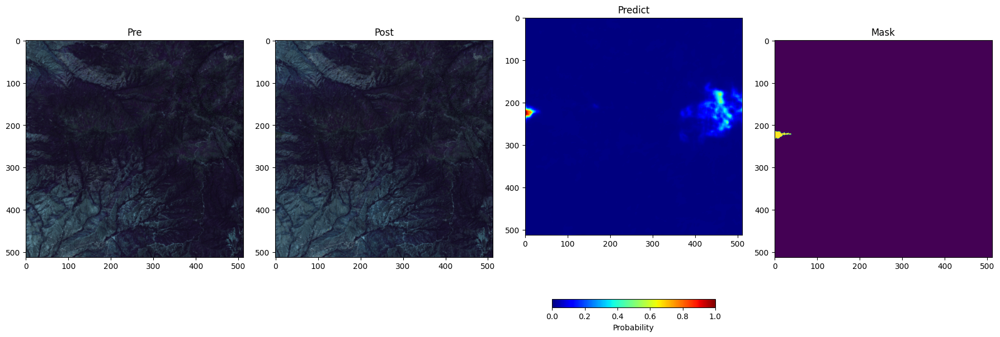

058dcb9e-f349-40bf-868b-7afa8dc9bb5a_0 3090_V6_CALFalseDEFFalseNONFalse_hrnet_w40BC32TH0.4_LR0.001T0100BETA0.25MIX0.5B8


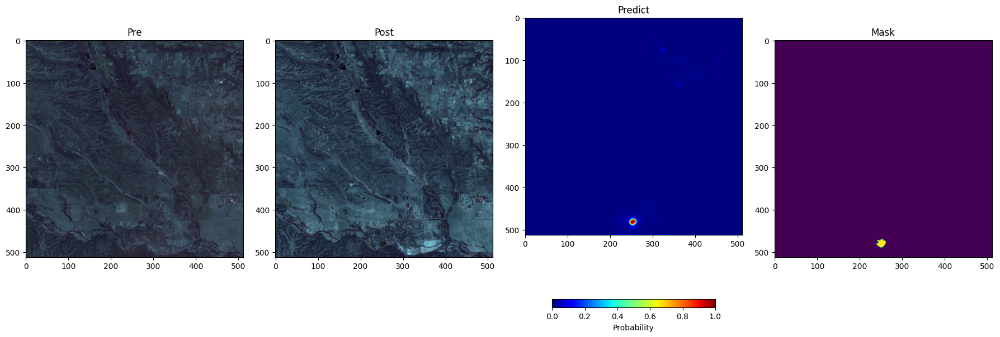

063bbb69-baf1-460b-95cc-9dfbe53ffe4a_0 3090_V6_CALFalseDEFFalseNONFalse_hrnet_w40BC32TH0.4_LR0.001T0100BETA0.25MIX0.5B8


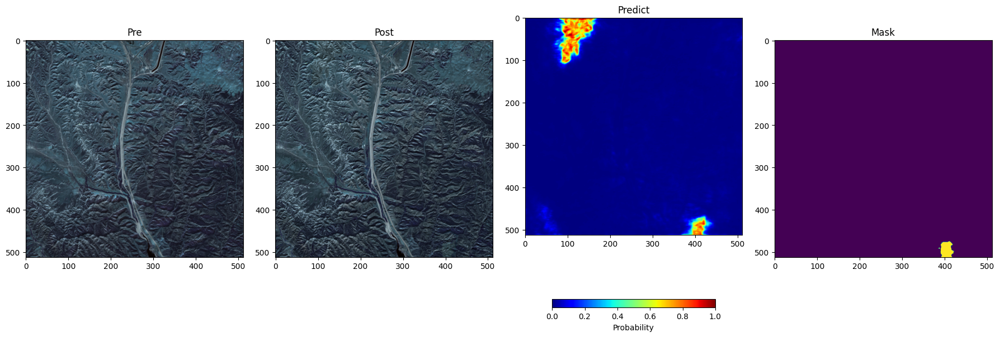

10e9b0b6-f9df-4c1d-9c1e-503cb7e37b7b_0 3090_V6_CALFalseDEFFalseNONFalse_hrnet_w40BC32TH0.4_LR0.001T0100BETA0.25MIX0.5B8


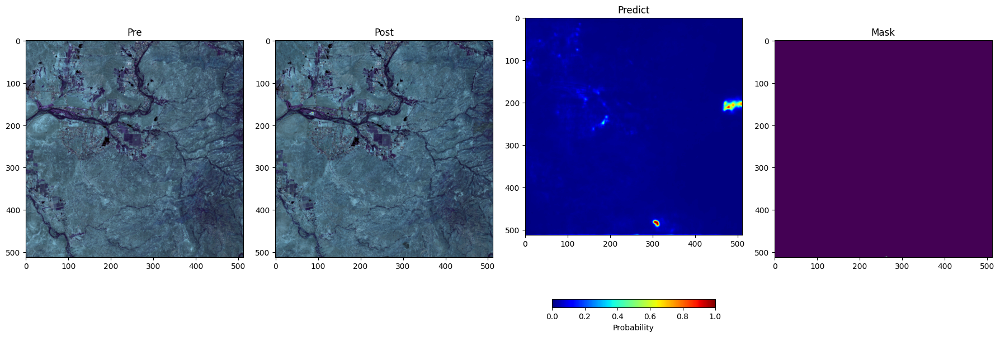

20cb665f-0a1e-4c4e-bb87-6bd88f6015c5_0 3090_V6_CALFalseDEFFalseNONFalse_hrnet_w40BC32TH0.4_LR0.001T0100BETA0.25MIX0.5B8


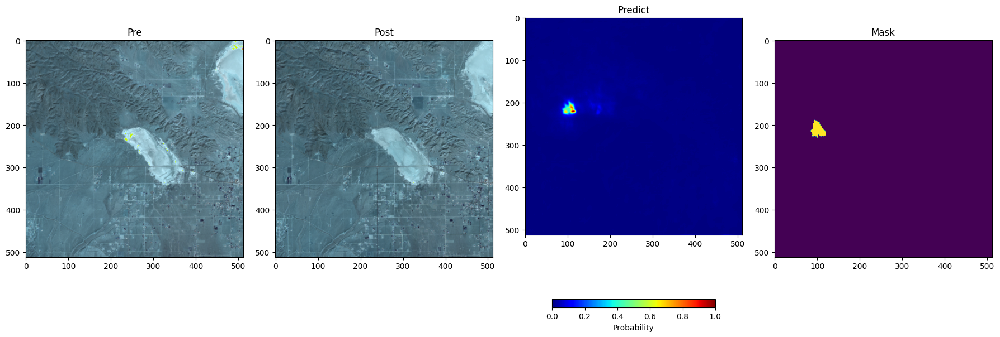

2e131813-25ad-4653-a3b2-95c8196a6228_6 3090_V6_CALFalseDEFFalseNONFalse_hrnet_w40BC32TH0.4_LR0.001T0100BETA0.25MIX0.5B8


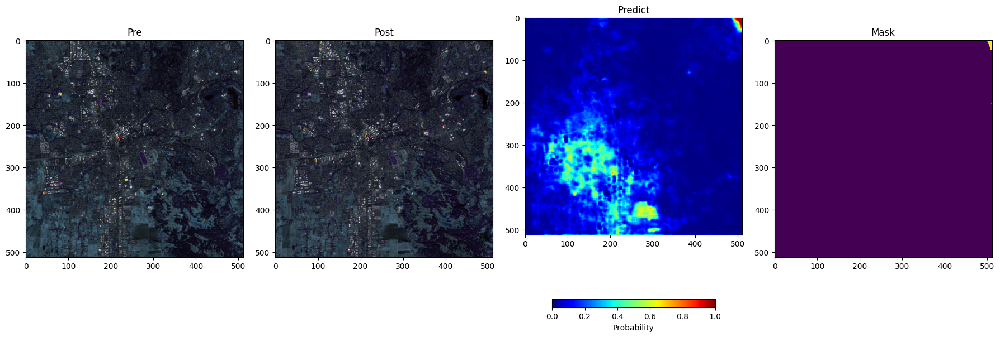

49f0aa55-5bcd-41c2-9acd-8d50ff884db7_0 3090_V6_CALFalseDEFFalseNONFalse_hrnet_w40BC32TH0.4_LR0.001T0100BETA0.25MIX0.5B8


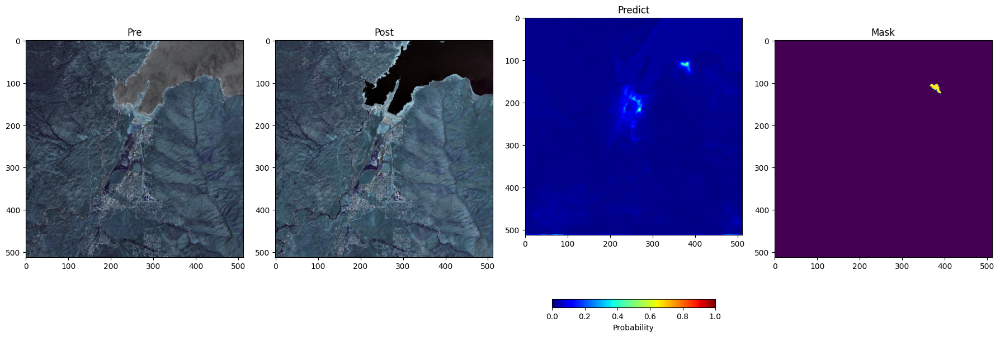

51b2fa4f-dfa2-49d1-b616-6d74c740fc44_0 3090_V6_CALFalseDEFFalseNONFalse_hrnet_w40BC32TH0.4_LR0.001T0100BETA0.25MIX0.5B8


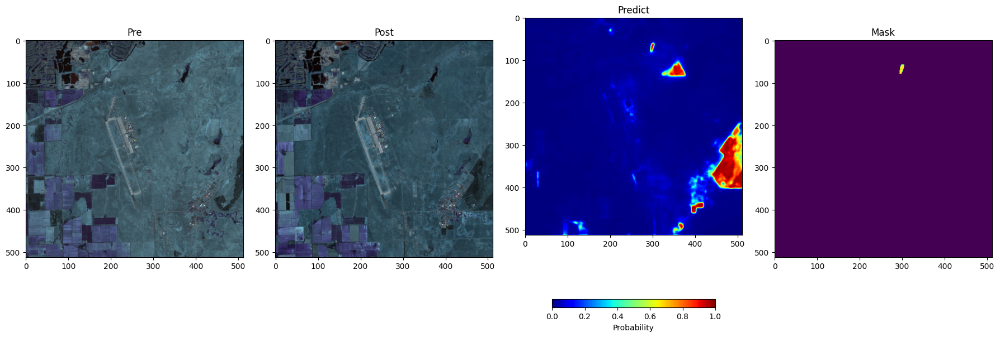

6396ce8b-6bd2-4c12-83bb-5ffa3c876cd3_0 3090_V6_CALFalseDEFFalseNONFalse_hrnet_w40BC32TH0.4_LR0.001T0100BETA0.25MIX0.5B8


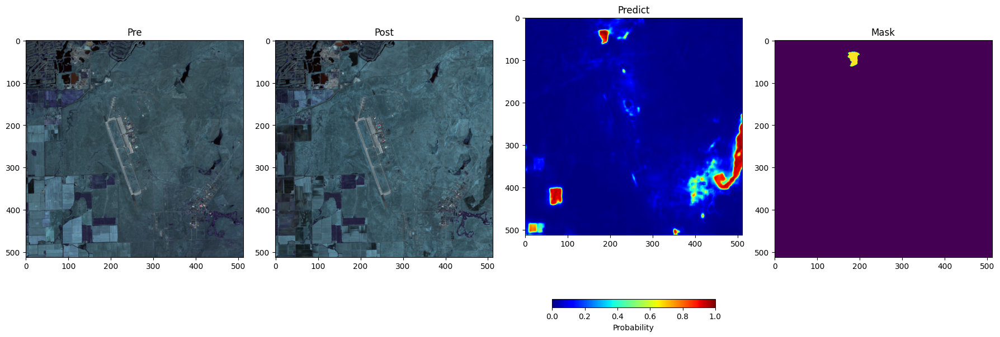

6483556c-1334-4495-8589-148462b0a33f_0 3090_V6_CALFalseDEFFalseNONFalse_hrnet_w40BC32TH0.4_LR0.001T0100BETA0.25MIX0.5B8


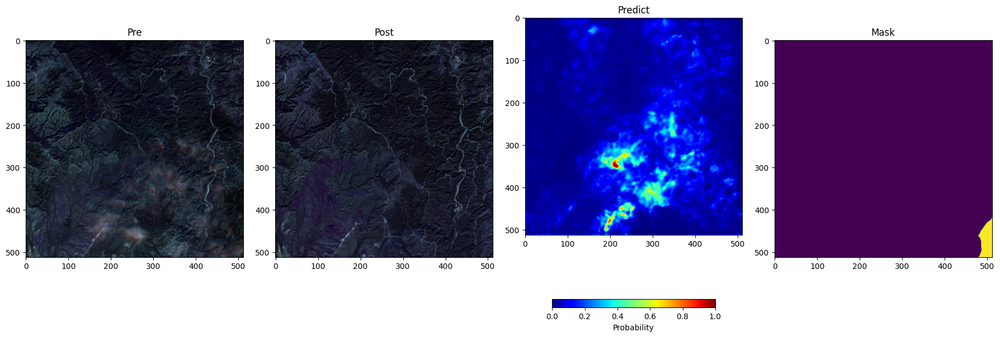

6483556c-1334-4495-8589-148462b0a33f_1 3090_V6_CALFalseDEFFalseNONFalse_hrnet_w40BC32TH0.4_LR0.001T0100BETA0.25MIX0.5B8


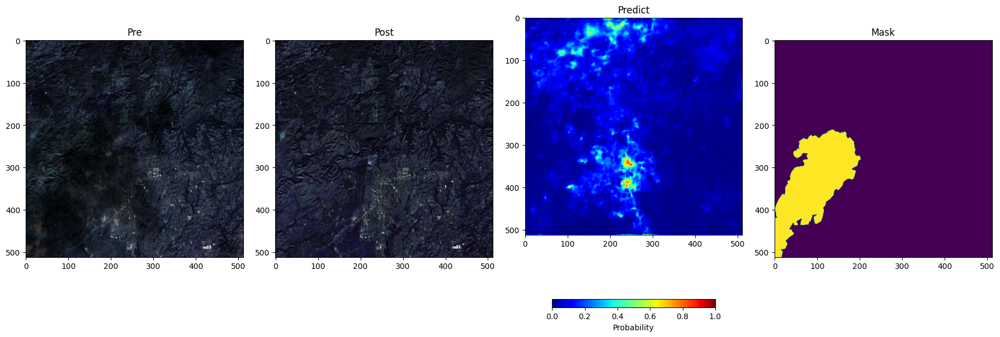

71ca42d1-a7b8-4de2-991d-3d9f5fdd0499_0 3090_V6_CALFalseDEFFalseNONFalse_hrnet_w40BC32TH0.4_LR0.001T0100BETA0.25MIX0.5B8


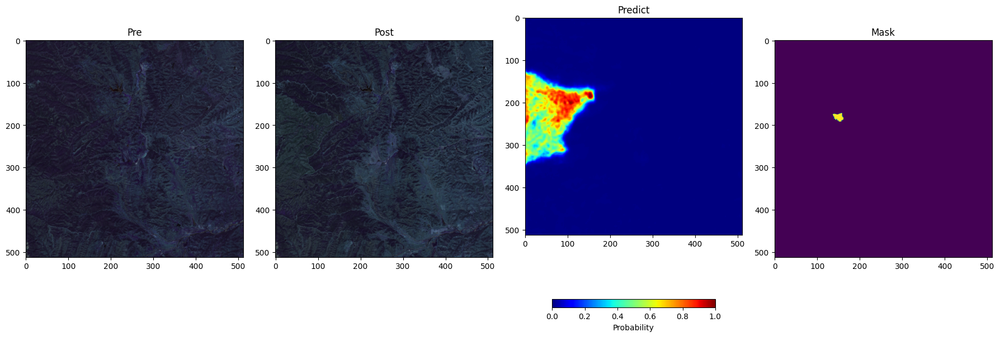

7592012c-ad9d-4ffa-8fd0-de56091a1453_0 3090_V6_CALFalseDEFFalseNONFalse_hrnet_w40BC32TH0.4_LR0.001T0100BETA0.25MIX0.5B8


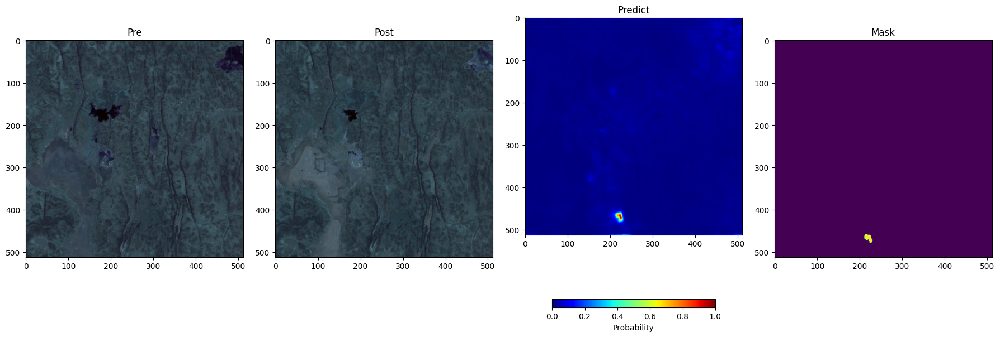

7b78a4d7-0659-49b8-9f7d-266fb70f6973_0 3090_V6_CALFalseDEFFalseNONFalse_hrnet_w40BC32TH0.4_LR0.001T0100BETA0.25MIX0.5B8


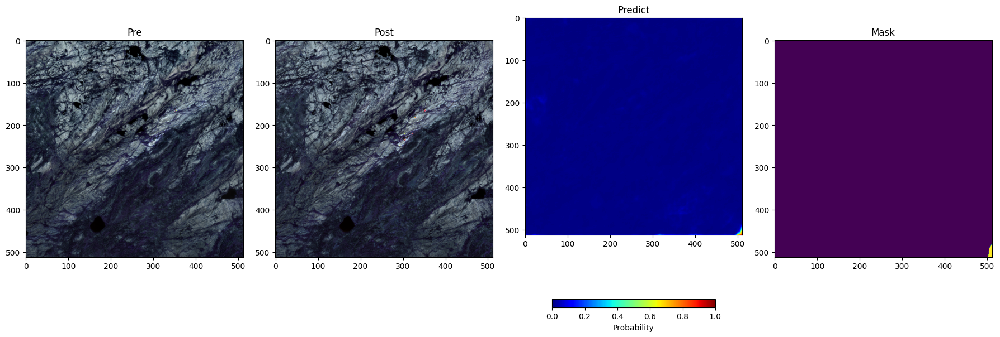

7b78a4d7-0659-49b8-9f7d-266fb70f6973_3 3090_V6_CALFalseDEFFalseNONFalse_hrnet_w40BC32TH0.4_LR0.001T0100BETA0.25MIX0.5B8


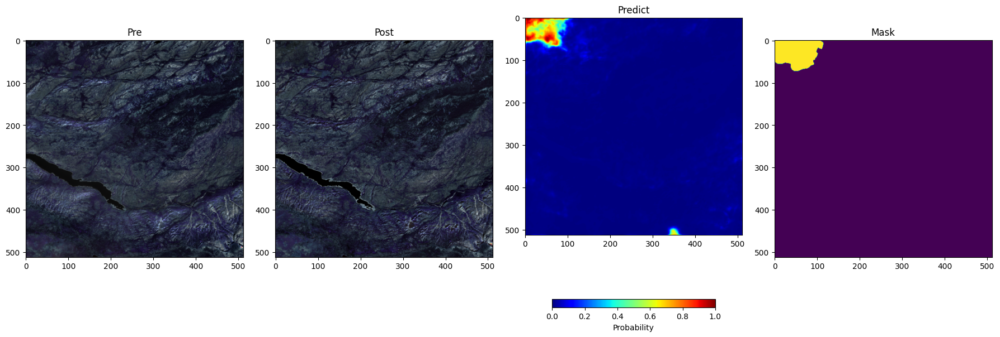

7df7928f-4807-4a89-8f98-826be7b7dc4d_0 3090_V6_CALFalseDEFFalseNONFalse_hrnet_w40BC32TH0.4_LR0.001T0100BETA0.25MIX0.5B8


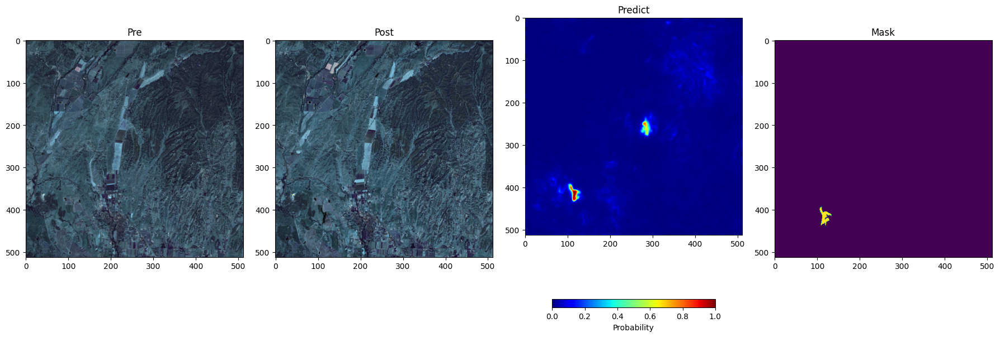

9267fd95-6d51-4ef8-95b0-4a330968a7d7_0 3090_V6_CALFalseDEFFalseNONFalse_hrnet_w40BC32TH0.4_LR0.001T0100BETA0.25MIX0.5B8


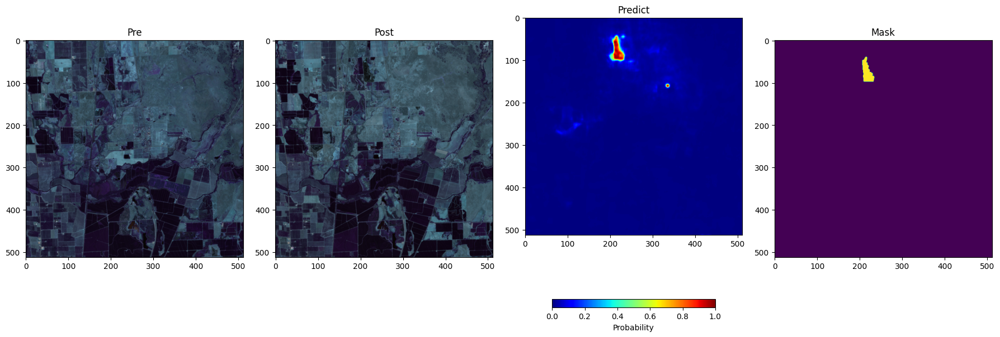

9399bc4d-dd61-44f8-aae1-754b00a6247b_0 3090_V6_CALFalseDEFFalseNONFalse_hrnet_w40BC32TH0.4_LR0.001T0100BETA0.25MIX0.5B8


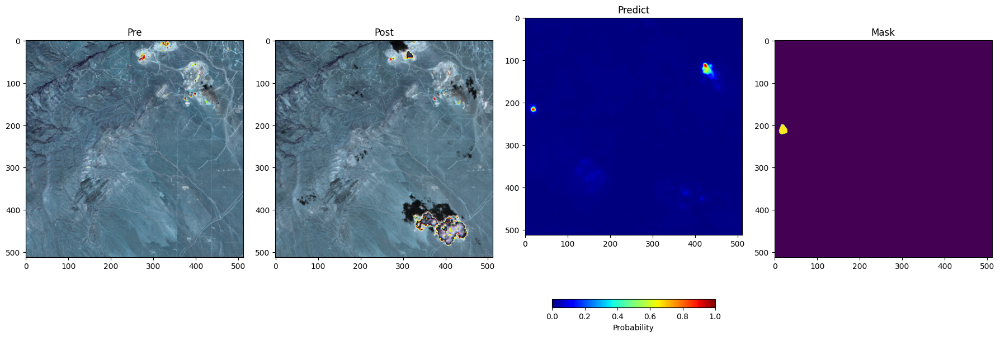

964b5e0b-8cc8-4f63-ae51-0e2ae2a94bab_0 3090_V6_CALFalseDEFFalseNONFalse_hrnet_w40BC32TH0.4_LR0.001T0100BETA0.25MIX0.5B8


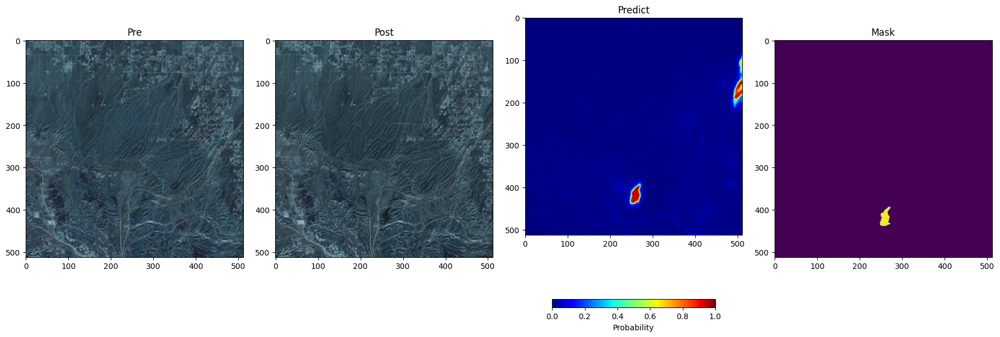

9dc544b1-46b0-45de-a01c-58d478f2298e_0 3090_V6_CALFalseDEFFalseNONFalse_hrnet_w40BC32TH0.4_LR0.001T0100BETA0.25MIX0.5B8


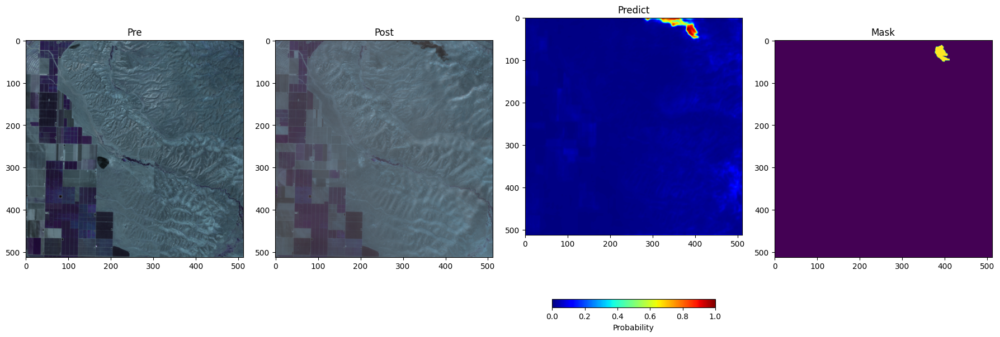

In [88]:
IDEXES = 20

for IDX in range(IDEXES):
    row = df.iloc[IDX]

    img = np.load(row.feature)
    post = (img[:, :, 2:5] / 5000 * 255).astype(np.uint8)
    pre = (img[:, :, 2+12:5+12] / 5000 * 255).astype(np.uint8)

    mask = np.load(row['mask'])

    PATH_CSV, NAME = row.csv, row['name']
    PATH_PRED = f'{os.path.dirname(PATH_CSV)}/visualize/{NAME}_output.png'
    print(NAME, PATH_CSV.split('/')[3])
    pred = cv2.imread(PATH_PRED).astype(np.float32)[:,:, 0]/255

    plt.figure(figsize=(18, 8))

    plt.subplot(1, 4, 1)
    plt.title('Pre')
    plt.imshow(pre)

    plt.subplot(1, 4, 2)
    plt.title('Post')
    plt.imshow(post)

    plt.subplot(1, 4, 3)
    plt.title('Predict')
    plt.imshow(pred, cmap='jet', vmin=0, vmax=1)
    plt.colorbar(shrink=0.75, label='Probability', orientation='horizontal')

    plt.subplot(1, 4, 4)
    plt.title('Mask')
    plt.imshow(mask)

    plt.tight_layout()

    plt.savefig(f'{cfg.outdir}/015_name_IDX{IDX}.png')
    plt.show();
    plt.clf()
    plt.close()